In [50]:
""" Imports """

from collections import namedtuple
import time
import os
import sys
import copy
import gc

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.autograd import Variable

from PIL import Image

import torchvision.transforms as transforms
import torchvision.models as models
from torch.utils.data import DataLoader
from torchvision import datasets

from utils import *
from style_subnet import *

# for auto-reloading external modules
# see http://stackoverflow.com/questions/1907993/autoreload-of-modules-in-ipython
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [51]:
IMAGE_SIZE = 256
BATCH_SIZE = 4
STYLE_NAME = "proj_style"
LR = 1e-3
NUM_EPOCHS = 2
CONTENT_WEIGHTS = [1, 1, 1]
STYLE_WEIGHTS = [2e4, 1e5, 1e3] # Checkpoint single style
#STYLE_WEIGHTS = [5e4, 8e4, 3e4] # Checkpoint two styles
# LAMBDAS = [1., 0.5, 0.25]
CONTENT_LAMBDA = 1.5
STYLE_LAMBDA = 5*10e-4
TV_LAMBDA = 3*10e-9
LAMBDAS = [1., STYLE_LAMBDA, TV_LAMBDA]
REG = 1e-7
LOG_INTERVAL = 100
MAX_ITERS = 10000

In [52]:
""" Allow PIL to read truncated blocks when loading images """

from PIL import ImageFile
ImageFile.LOAD_TRUNCATED_IMAGES = True

In [53]:
""" Add a seed to have reproducable results """

SEED = 1080
torch.manual_seed(SEED)

In [54]:
""" Configure training with or without cuda """

if torch.cuda.is_available():
    device = torch.device("cuda")
    torch.cuda.manual_seed(SEED)
    torch.set_default_tensor_type('torch.cuda.FloatTensor')
    kwargs = {'num_workers': 4, 'pin_memory': True}
else:
    device = torch.device("cpu")
    torch.set_default_tensor_type('torch.FloatTensor')
    kwargs = {}

In [55]:
""" Load coco dataset """

print("Loading dataset..")
scriptDir = os.path.dirname(os.path.realpath('__file__'))
DATASET = scriptDir
transform = transforms.Compose([transforms.Resize(IMAGE_SIZE),
                                transforms.CenterCrop(IMAGE_SIZE),
                                transforms.ToTensor(), tensor_normalizer()])
# http://pytorch.org/docs/master/torchvision/datasets.html#imagefolder
train_dataset = datasets.ImageFolder(DATASET, transform)
# http://pytorch.org/docs/master/data.html#torch.utils.data.DataLoader
train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=False, **kwargs)

Loading dataset..


In [56]:
""" Load Style Image """

style_img_256, style_img_512, style_img_1024 = style_loader(
    "styles/" + STYLE_NAME + ".jpg", device, [256, 512, 1024])

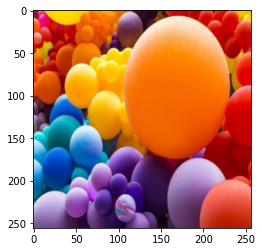

In [57]:
imshow(style_img_256)

In [58]:
""" Define Loss Network """
########## ["relu1_1", "relu2_2", "relu3_3", "relu4_3"] ##########
StyleOutput = namedtuple("StyleOutput", ["relu1_1", "relu2_2", "relu3_3", "relu4_3"])

########## ["relu2_2"] ##########
ContentOutput = namedtuple("ContentOutput", ["relu2_2"])

# https://discuss.pytorch.org/t/how-to-extract-features-of-an-image-from-a-trained-model/119/3
class LossNetwork(torch.nn.Module):
    def __init__(self, vgg):
        super(LossNetwork, self).__init__()
        self.vgg = vgg
        self.layer_name_mapping = {
            '1': "relu1_1", '3': "relu1_2",
            '6': "relu2_1", '8': "relu2_2",
            '11': "relu3_1", '13': "relu3_2", '15': "relu3_3", '17': "relu3_4",
            '20': "relu4_1", '22': "relu4_2", '24': "relu4_3", '26': "relu4_4",
            '29': "relu5_1", '31': "relu5_2", '33': "relu5_3", '35': "relu5_4"
        }

    def forward(self, x, mode):
        if mode == 'style':
            ########## ["relu1_1", "relu2_2", "relu3_3", "relu4_3"] ##########
            ########## ['1', '8', '15', '24'] ##########
            layers = ['1', '8', '15', '24']
        elif mode == 'content':
            ########## ["relu2_2"] ##########
            ########## ['8'] ##########
            layers = ['8']
        else:
            print("Invalid mode. Select between 'style' and 'content'")
        output = {}
        for name, module in self.vgg._modules.items():
            x = module(x)
            if name in layers:
                output[self.layer_name_mapping[name]] = x
        if mode == 'style':
            return StyleOutput(**output)
        else:
            return ContentOutput(**output)

In [59]:
""" Load and extract features from VGG16 """

print("Loading VGG..")
vgg = models.vgg19(pretrained=True).features.to(device).eval()
loss_network = LossNetwork(vgg).to(device).eval()
del vgg

Loading VGG..


In [60]:
""" Before training, compute the features of every resolution of the style image """

print("Computing style features..")
with torch.no_grad(): 
    style_loss_features_256 = loss_network(Variable(style_img_256), 'style')

gram_style_256 = [Variable(gram_matrix(y).data, requires_grad=False) for y in style_loss_features_256]

Computing style features..


In [61]:
""" Init Net and loss """

style_subnet = StyleSubnet().to(device)

In [62]:
""" Prepare Training """

max_iterations = min(MAX_ITERS, len(train_dataset))

# init loss
mse_loss = torch.nn.MSELoss()
# init optimizer
optimizer = torch.optim.Adam(list(style_subnet.parameters()), lr=LR)

def getLosses(generated_img, resized_input_img, content_weight, style_weight, mse_loss, gram_style):
    
    # Compute features
    generated_style_features = loss_network(generated_img, 'style')
    generated_content_features = loss_network(generated_img, 'content')
    target_content_features = loss_network(resized_input_img, 'content')
    
    # Content loss
    target_content_features = Variable(target_content_features[0].data, requires_grad=False)
    content_loss = content_weight * mse_loss(generated_content_features[0], target_content_features)
    
    # Style loss
    style_loss = 0.
    for m in range(len(generated_style_features)):
        gram_s = gram_style[m]
        gram_y = gram_matrix(generated_style_features[m])
        style_loss += style_weight * mse_loss(gram_y, gram_s.expand_as(gram_y))
    
    # Regularization loss
    reg_loss = REG * (
        torch.sum(torch.abs(generated_img[:, :, :, :-1] - generated_img[:, :, :, 1:])) + 
        torch.sum(torch.abs(generated_img[:, :, :-1, :] - generated_img[:, :, 1:, :])))
    
    return content_loss, style_loss, reg_loss

Start training on cuda...
Sat Jan  9 21:59:27 2021 [25/500] time per pass: 0.61s  total time: 15.18s  estimated time left: 0.08h  content: 6.935589  style: 14.888722  reg: 0.010951  total: 21.835262


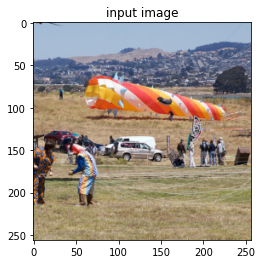

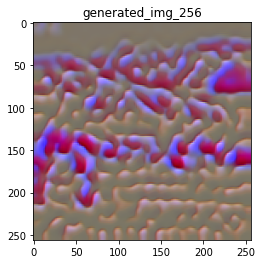

Sat Jan  9 21:59:36 2021 [50/500] time per pass: 0.48s  total time: 23.88s  estimated time left: 0.06h  content: 7.072175  style: 6.049483  reg: 0.013533  total: 13.135190


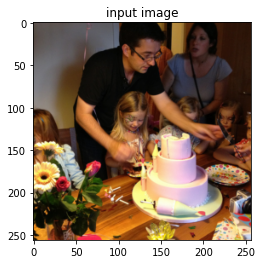

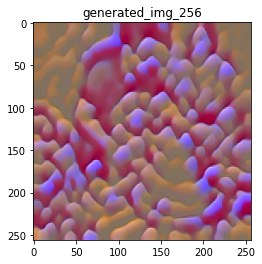

Sat Jan  9 21:59:45 2021 [75/500] time per pass: 0.43s  total time: 32.58s  estimated time left: 0.05h  content: 7.022583  style: 4.126563  reg: 0.013693  total: 11.162838


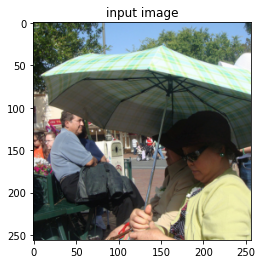

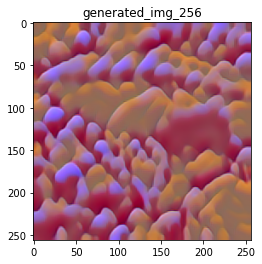

Sat Jan  9 21:59:53 2021 [100/500] time per pass: 0.41s  total time: 41.33s  estimated time left: 0.05h  content: 6.864674  style: 3.474040  reg: 0.013444  total: 10.352157


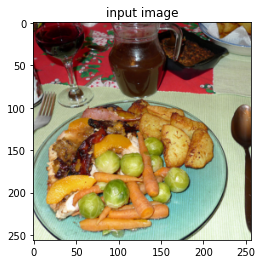

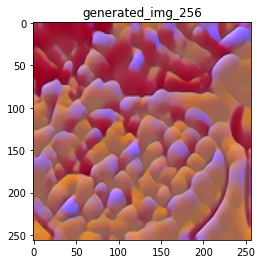

Sat Jan  9 22:00:02 2021 [125/500] time per pass: 0.40s  total time: 50.12s  estimated time left: 0.04h  content: 6.970832  style: 3.200399  reg: 0.013629  total: 10.184860


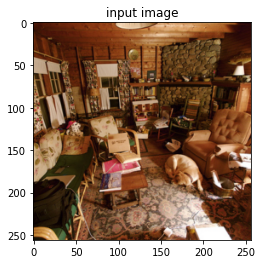

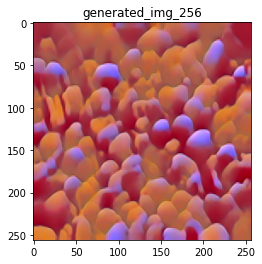

Sat Jan  9 22:00:11 2021 [150/500] time per pass: 0.39s  total time: 58.90s  estimated time left: 0.04h  content: 6.756567  style: 2.744474  reg: 0.013485  total: 9.514525


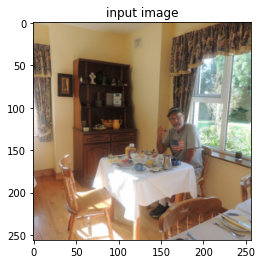

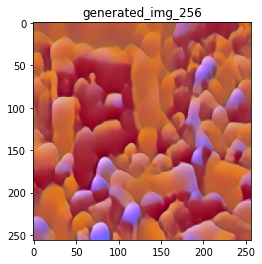

Sat Jan  9 22:00:20 2021 [175/500] time per pass: 0.39s  total time: 67.69s  estimated time left: 0.04h  content: 6.647916  style: 2.626983  reg: 0.013333  total: 9.288232


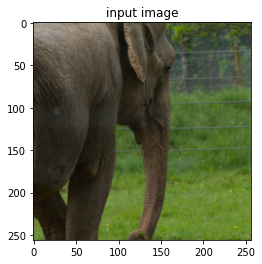

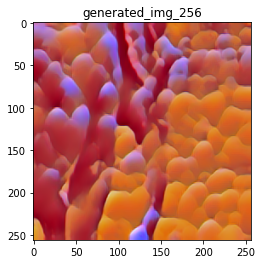

Sat Jan  9 22:00:29 2021 [200/500] time per pass: 0.38s  total time: 76.50s  estimated time left: 0.03h  content: 6.613304  style: 2.611710  reg: 0.013082  total: 9.238096


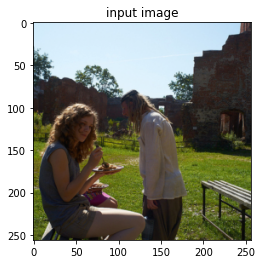

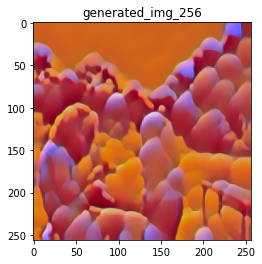

Sat Jan  9 22:00:37 2021 [225/500] time per pass: 0.38s  total time: 85.21s  estimated time left: 0.03h  content: 6.437838  style: 2.392340  reg: 0.013341  total: 8.843518


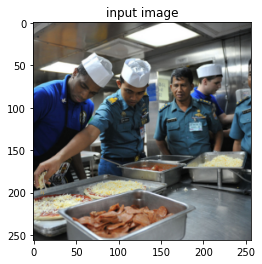

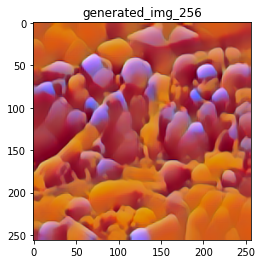

Sat Jan  9 22:00:46 2021 [250/500] time per pass: 0.38s  total time: 93.99s  estimated time left: 0.03h  content: 6.250537  style: 2.440142  reg: 0.013371  total: 8.704051


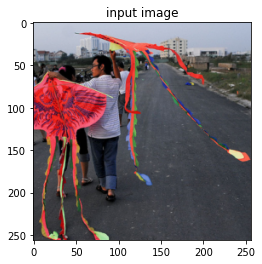

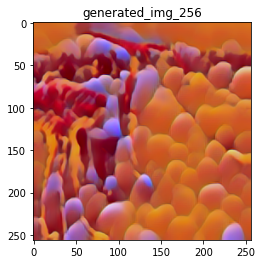

Sat Jan  9 22:00:55 2021 [275/500] time per pass: 0.37s  total time: 102.78s  estimated time left: 0.02h  content: 6.174030  style: 2.378013  reg: 0.013428  total: 8.565471


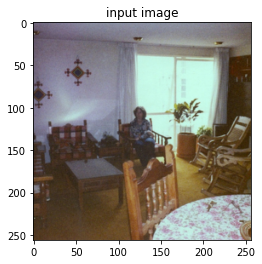

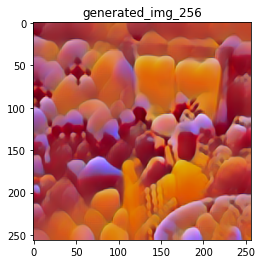

Sat Jan  9 22:01:04 2021 [300/500] time per pass: 0.37s  total time: 111.61s  estimated time left: 0.02h  content: 6.189205  style: 2.227551  reg: 0.013766  total: 8.430522


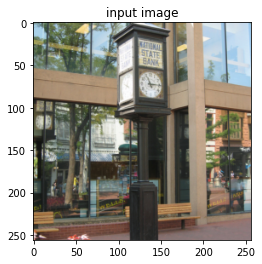

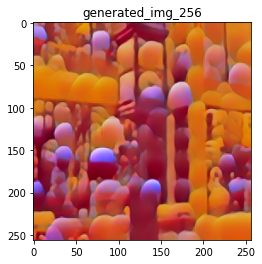

Sat Jan  9 22:01:12 2021 [325/500] time per pass: 0.37s  total time: 120.33s  estimated time left: 0.02h  content: 6.060359  style: 2.471053  reg: 0.013725  total: 8.545136


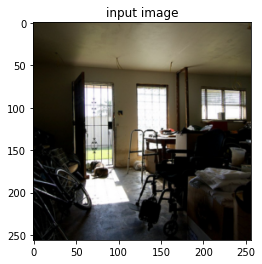

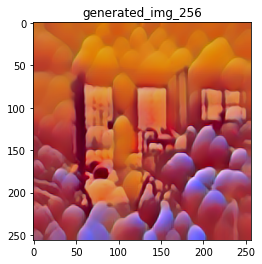

Sat Jan  9 22:01:21 2021 [350/500] time per pass: 0.37s  total time: 128.92s  estimated time left: 0.02h  content: 6.029972  style: 2.415869  reg: 0.013759  total: 8.459600


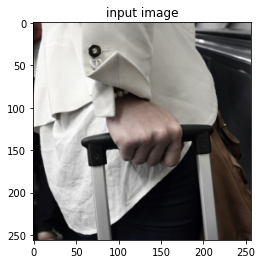

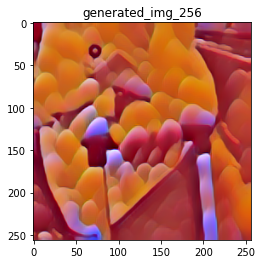

Sat Jan  9 22:01:30 2021 [375/500] time per pass: 0.37s  total time: 137.63s  estimated time left: 0.01h  content: 5.797320  style: 2.244594  reg: 0.013772  total: 8.055686


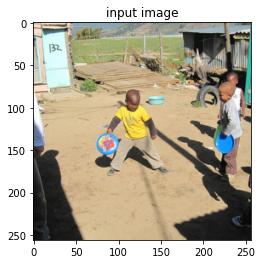

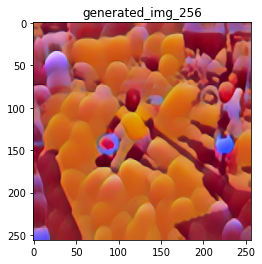

Sat Jan  9 22:01:38 2021 [400/500] time per pass: 0.37s  total time: 146.18s  estimated time left: 0.01h  content: 5.829474  style: 2.125974  reg: 0.014020  total: 7.969469


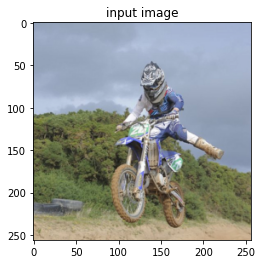

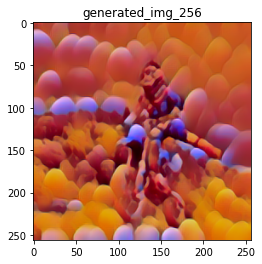

Sat Jan  9 22:01:47 2021 [425/500] time per pass: 0.36s  total time: 154.57s  estimated time left: 0.01h  content: 5.576385  style: 2.201676  reg: 0.013759  total: 7.791819


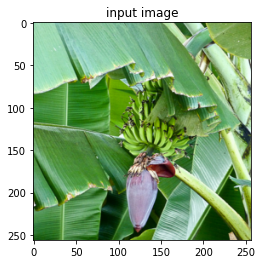

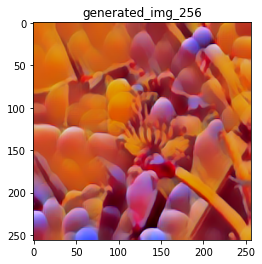

Sat Jan  9 22:01:55 2021 [450/500] time per pass: 0.36s  total time: 163.11s  estimated time left: 0.01h  content: 5.646546  style: 2.091453  reg: 0.014080  total: 7.752079


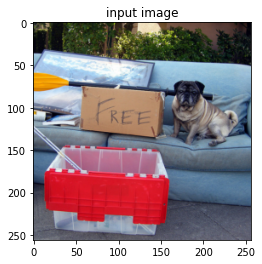

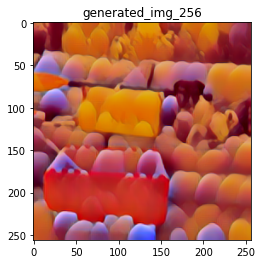

Sat Jan  9 22:02:04 2021 [475/500] time per pass: 0.36s  total time: 171.79s  estimated time left: 0.00h  content: 5.501929  style: 2.019379  reg: 0.014229  total: 7.535537


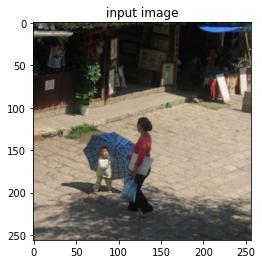

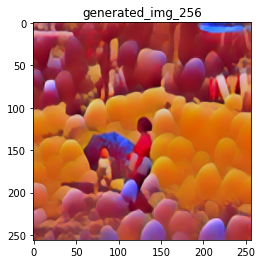

Sat Jan  9 22:02:12 2021 [500/500] time per pass: 0.36s  total time: 180.42s  estimated time left: 0.00h  content: 5.521305  style: 1.994207  reg: 0.014348  total: 7.529859


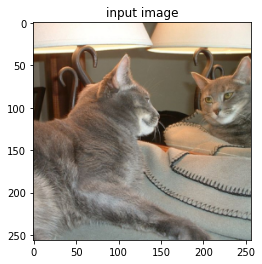

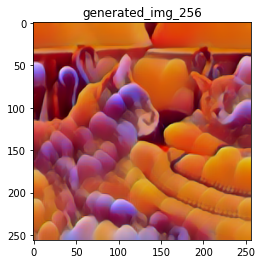

Sat Jan  9 22:02:29 2021 [25/500] time per pass: 7.86s  total time: 196.55s  estimated time left: 1.04h  content: 5.503264  style: 2.007410  reg: 0.014479  total: 7.525154


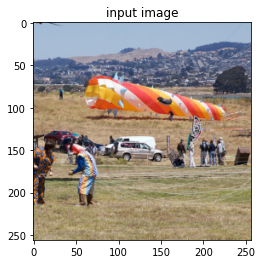

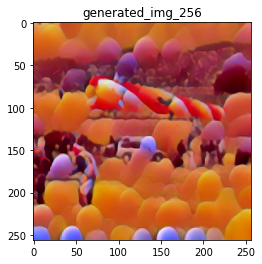

Sat Jan  9 22:02:37 2021 [50/500] time per pass: 4.10s  total time: 205.10s  estimated time left: 0.51h  content: 5.190979  style: 1.982071  reg: 0.014383  total: 7.187433


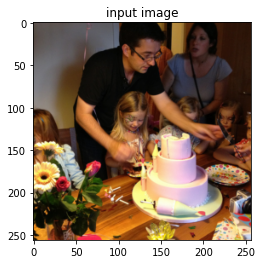

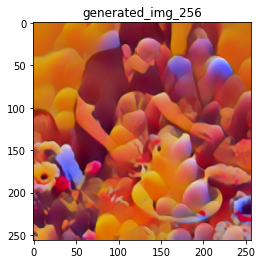

Sat Jan  9 22:02:46 2021 [75/500] time per pass: 2.85s  total time: 213.85s  estimated time left: 0.34h  content: 5.199618  style: 2.051531  reg: 0.014337  total: 7.265486


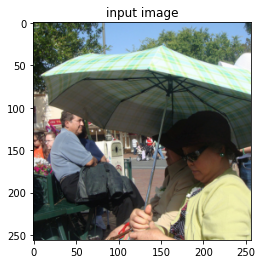

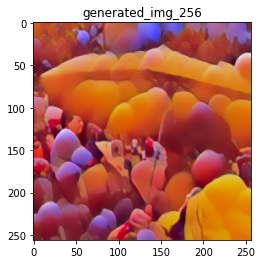

Sat Jan  9 22:02:55 2021 [100/500] time per pass: 2.23s  total time: 222.71s  estimated time left: 0.25h  content: 5.177743  style: 1.988974  reg: 0.014476  total: 7.181194


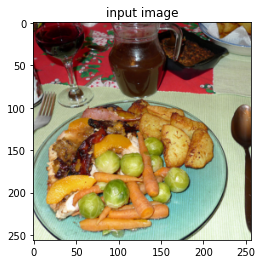

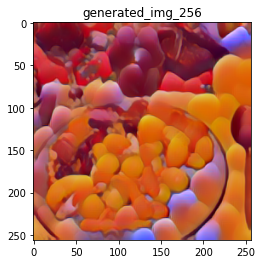

Sat Jan  9 22:03:04 2021 [125/500] time per pass: 1.85s  total time: 231.54s  estimated time left: 0.19h  content: 5.303979  style: 2.041875  reg: 0.014685  total: 7.360539


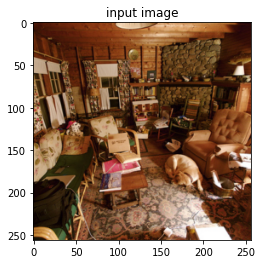

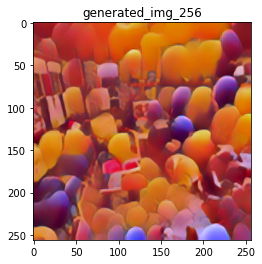

Sat Jan  9 22:03:12 2021 [150/500] time per pass: 1.60s  total time: 240.36s  estimated time left: 0.16h  content: 5.091418  style: 1.963990  reg: 0.014761  total: 7.070170


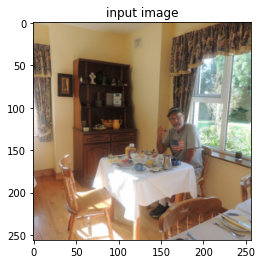

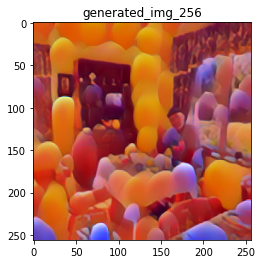

Sat Jan  9 22:03:21 2021 [175/500] time per pass: 1.42s  total time: 249.20s  estimated time left: 0.13h  content: 5.121033  style: 1.972561  reg: 0.014725  total: 7.108320


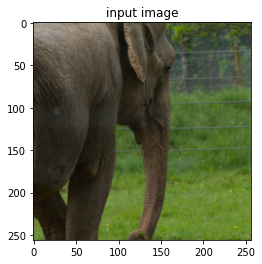

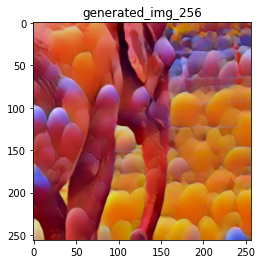

Sat Jan  9 22:03:30 2021 [200/500] time per pass: 1.29s  total time: 258.01s  estimated time left: 0.11h  content: 5.182099  style: 1.999498  reg: 0.014692  total: 7.196289


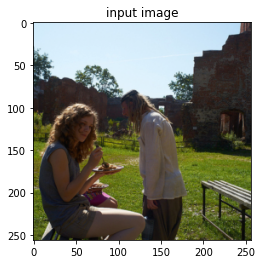

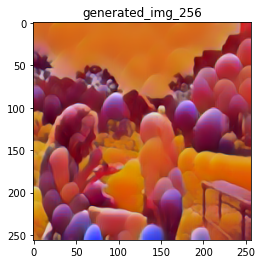

Sat Jan  9 22:03:39 2021 [225/500] time per pass: 1.19s  total time: 266.84s  estimated time left: 0.09h  content: 5.130702  style: 1.992519  reg: 0.015001  total: 7.138221


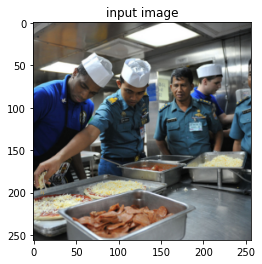

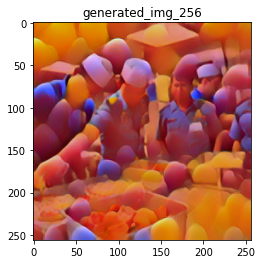

Sat Jan  9 22:03:48 2021 [250/500] time per pass: 1.10s  total time: 275.69s  estimated time left: 0.08h  content: 5.129638  style: 1.947355  reg: 0.014793  total: 7.091786


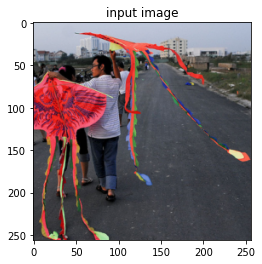

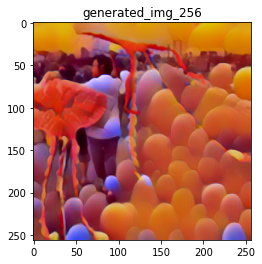

Sat Jan  9 22:03:56 2021 [275/500] time per pass: 1.03s  total time: 284.49s  estimated time left: 0.06h  content: 5.049468  style: 1.900224  reg: 0.014720  total: 6.964411


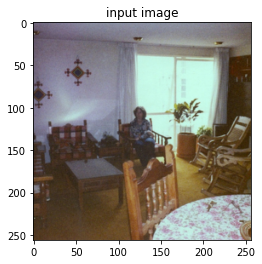

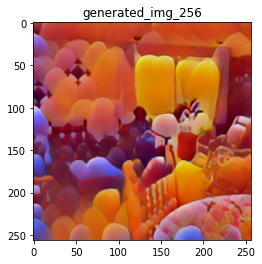

Sat Jan  9 22:04:05 2021 [300/500] time per pass: 0.98s  total time: 293.38s  estimated time left: 0.05h  content: 5.092402  style: 1.896975  reg: 0.015191  total: 7.004568


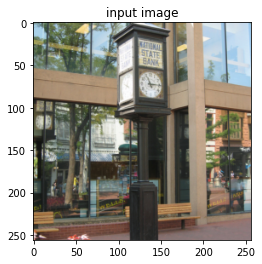

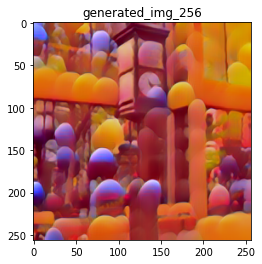

Sat Jan  9 22:04:14 2021 [325/500] time per pass: 0.93s  total time: 302.27s  estimated time left: 0.05h  content: 4.991327  style: 1.931734  reg: 0.015093  total: 6.938154


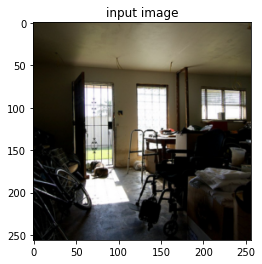

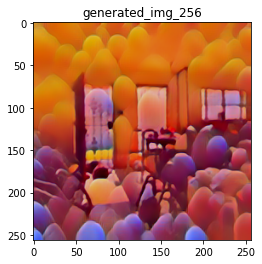

Sat Jan  9 22:04:23 2021 [350/500] time per pass: 0.89s  total time: 311.12s  estimated time left: 0.04h  content: 4.966259  style: 1.905037  reg: 0.015091  total: 6.886388


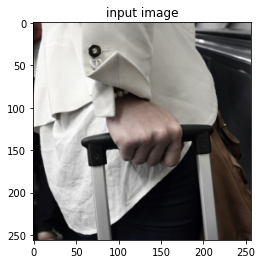

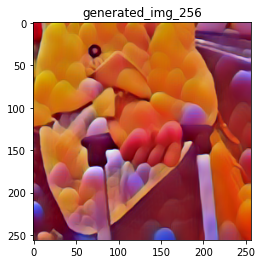

Sat Jan  9 22:04:32 2021 [375/500] time per pass: 0.85s  total time: 319.91s  estimated time left: 0.03h  content: 4.827940  style: 1.875536  reg: 0.015120  total: 6.718596


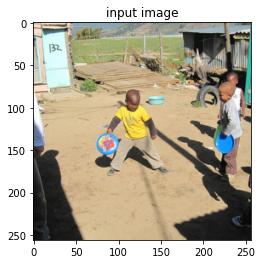

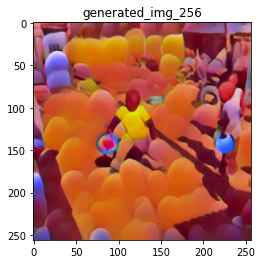

Sat Jan  9 22:04:41 2021 [400/500] time per pass: 0.82s  total time: 328.79s  estimated time left: 0.02h  content: 4.929534  style: 1.901963  reg: 0.015376  total: 6.846873


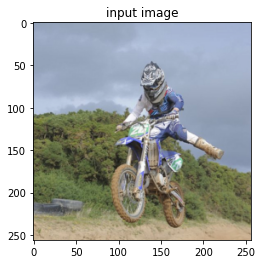

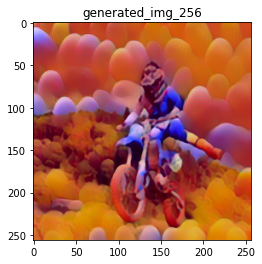

Sat Jan  9 22:04:50 2021 [425/500] time per pass: 0.79s  total time: 337.66s  estimated time left: 0.02h  content: 4.786448  style: 1.834173  reg: 0.014880  total: 6.635501


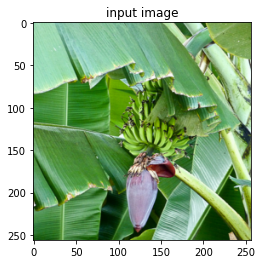

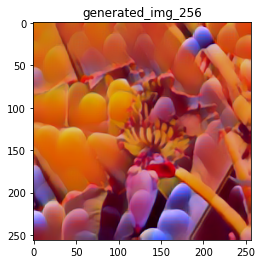

Sat Jan  9 22:04:59 2021 [450/500] time per pass: 0.77s  total time: 346.58s  estimated time left: 0.01h  content: 4.848378  style: 1.876316  reg: 0.015385  total: 6.740079


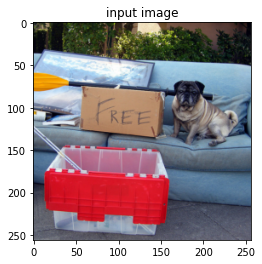

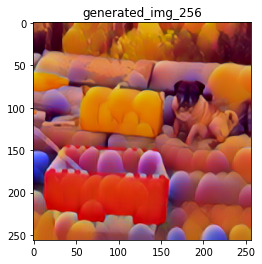

Sat Jan  9 22:05:07 2021 [475/500] time per pass: 0.75s  total time: 355.45s  estimated time left: 0.01h  content: 4.780542  style: 1.834130  reg: 0.015354  total: 6.630027


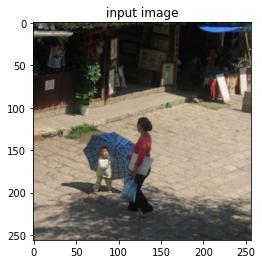

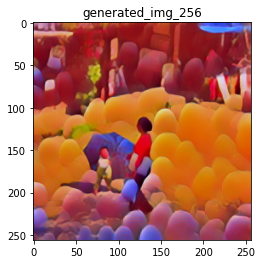

Sat Jan  9 22:05:16 2021 [500/500] time per pass: 0.73s  total time: 364.27s  estimated time left: 0.00h  content: 4.806397  style: 1.814887  reg: 0.015564  total: 6.636848


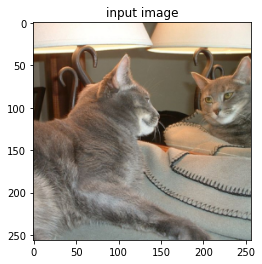

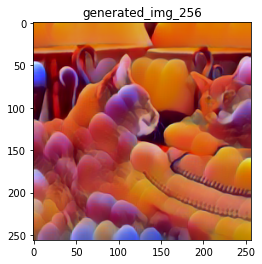

In [63]:
""" Perform Training """

style_subnet.train()
start = time.time()
print("Start training on {}...".format(device))
for epoch in range(NUM_EPOCHS):
    agg_content_loss, agg_style_loss, agg_reg_loss = 0., 0., 0.
    log_counter = 0
    for i, (x, _) in enumerate(train_loader):
        
        
        # update learning rate every 2000 iterations
        if i % 2000 == 0 and i != 0:
            LR = LR * 0.8
            optimizer = torch.optim.Adam(list(style_subnet.parameters()), lr=LR)


        optimizer.zero_grad()
        x_in = x.clone()
        
        """ Style Subnet """
        x_in = Variable(x_in).to(device)

        # Generate image
        generated_img_256, resized_input_img_256 = style_subnet(x_in)
        resized_input_img_256 = Variable(resized_input_img_256.data)
        
        # Compute Losses
        style_subnet_content_loss, style_subnet_style_loss, style_subnet_reg_loss = getLosses(
            generated_img_256,
            resized_input_img_256,
            CONTENT_WEIGHTS[0],
            STYLE_WEIGHTS[0],
            mse_loss, gram_style_256)
        

        # Total loss
        total_loss = LAMBDAS[0] * (style_subnet_content_loss + style_subnet_style_loss + style_subnet_reg_loss)
        total_loss.backward()
        optimizer.step()

        # Aggregated loss
        agg_content_loss += style_subnet_content_loss.data
        agg_style_loss += style_subnet_style_loss.data
        agg_reg_loss += style_subnet_reg_loss.data
        
        
        # log training process
        if (i + 1) % LOG_INTERVAL == 0:
            log_counter += 1
            hlp = log_counter * LOG_INTERVAL
            time_per_pass = (time.time() - start) / hlp
            estimated_time_left = (time_per_pass * (max_iterations - i))/3600
            print("{} [{}/{}] time per pass: {:.2f}s  total time: {:.2f}s  estimated time left: {:.2f}h  content: {:.6f}  style: {:.6f}  reg: {:.6f}  total: {:.6f}".format(
                        time.ctime(), i+1, max_iterations,
                        (time.time() - start) / hlp,
                        time.time() - start,
                        estimated_time_left,
                        agg_content_loss / LOG_INTERVAL,
                        agg_style_loss / LOG_INTERVAL,
                        agg_reg_loss / LOG_INTERVAL,
                        (agg_content_loss + agg_style_loss + agg_reg_loss) / LOG_INTERVAL))
            agg_content_loss, agg_style_loss, agg_reg_loss = 0., 0., 0.
            imshow(x[0], title="input image")
            imshow(generated_img_256[0], title="generated_img_256")

        """
        if (i + 1) % (10 * LOG_INTERVAL) == 0:
            save_image(generated_img_256, title="log_data/256_iteration_{}_of_{}".format(i+1, max_iterations))

            torch.save(style_subnet, 'log_data/trained_style_subnet_it_{}_of_{}.pt'.format(i+1, max_iterations))
            print("Images and model saved in /log_one_data")
        """

        # Stop training after max iterations
        if (i + 1) == max_iterations: break

""" Save model """
torch.save(style_subnet, 'models/style_subnet_trained2.pt')
torch.save(style_subnet, "models/style_subnet_trained_{}_{}.pt".format(STYLE_NAME,time.time()))